Tiffany Lo | TYL180000
---


CS 4372.501, Assignment 2:
Trees


# Libraries and Data Loading

In [ ]:
!pip install scikit-plot
!pip install sklearn-evaluation

Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
Looking in indexes: https://pypi.org/simple, https://us-python.pkg.dev/colab-wheels/public/simple/
     |████████████████████████████████| 56 kB 3.4 MB/s 
     |████████████████████████████████| 1.5 MB 8.7 MB/s 
     |████████████████████████████████| 843 kB 40.8 MB/s 
     |████████████████████████████████| 96 kB 4.3 MB/s 
     |████████████████████████████████| 1.6 MB 15.3 MB/s 
  Attempting uninstall: click
    Found existing installation: click 7.1.2
    Uninstalling click-7.1.2:
      Successfully uninstalled click-7.1.2
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
flask 1.1.4 requires click<8.0,>=5.1, but you have click 8.1.3 which is incompatible.


In [ ]:
# Import files and libraries
import pandas as pd
import numpy as np
import sklearn
import seaborn as sns
import urllib.request as urllib2
import warnings
import matplotlib.pyplot as plt
import xgboost as xgb
import multiprocessing
import datetime
import graphviz
import scikitplot as skplt
import matplotlib.pyplot as plt
import statsmodels.api as sm
from statsmodels.sandbox.regression.predstd import wls_prediction_std
from sklearn.model_selection import train_test_split
from sklearn.model_selection import train_test_split, cross_val_score
from sklearn.metrics import accuracy_score, precision_score, confusion_matrix, mean_squared_error, mean_absolute_error, r2_score, explained_variance_score
from sklearn.linear_model import LinearRegression
from datetime import datetime
from sklearn.metrics import mean_squared_error, mean_absolute_error
from sklearn.preprocessing import MinMaxScaler
from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import GridSearchCV
from sklearn.pipeline import Pipeline
from sklearn_evaluation import plot
from sklearn.metrics import accuracy_score, classification_report
from sklearn import tree
import graphviz
from sklearn import metrics
from sklearn.metrics import r2_score
from sklearn.tree import export_graphviz
from sklearn.linear_model import SGDRegressor
from sklearn.ensemble import RandomForestClassifier, AdaBoostClassifier, RandomForestRegressor, AdaBoostRegressor
from sklearn.tree import DecisionTreeClassifier
from sklearn import preprocessing
from sklearn import utils
from sklearn.tree import DecisionTreeRegressor
from zipfile import ZipFile
from io import BytesIO

# Supress warnings
warnings.filterwarnings("ignore")

In [ ]:
# Obtain and load data
url = urllib2.urlopen("https://archive.ics.uci.edu/ml/machine-learning-databases/00360/AirQualityUCI.zip").read()
files = ZipFile(BytesIO(url))

filenames = files.namelist()

myCSV = files.open(filenames[1])

# Create DF
data = pd.read_excel(myCSV, na_values = '-200.0')

# Data Exploration and Cleaning

In [ ]:
data.describe()

,CO(GT),PT08.S1(CO),NMHC(GT),C6H6(GT),PT08.S2(NMHC),NOx(GT),PT08.S3(NOx),NO2(GT),PT08.S4(NO2),PT08.S5(O3),T,RH,AH
count,7674.000000,8991.000000,9357.000000,8991.000000,8991.000000,7718.000000,8991.000000,7715.000000,8991.000000,8991.000000,8991.000000,8991.000000,8991.000000
mean,2.152750,1099.707856,-159.090093,10.082993,939.029205,246.881252,835.370973,113.075515,1456.143486,1022.780725,18.316054,49.232360,1.025530
std,1.453252,217.084571,139.789093,7.449640,266.829000,212.971224,256.815106,48.359250,346.204540,398.480897,8.832888,17.316389,0.403813
min,0.100000,647.250000,-200.000000,0.149048,383.250000,2.000000,322.000000,2.000000,551.000000,221.000000,-1.900000,9.175000,0.184679
25%,1.100000,936.750000,-200.000000,4.436942,734.375000,98.000000,657.875000,78.000000,1226.625000,731.375000,11.787500,35.812500,0.736769
50%,1.800000,1063.000000,-200.000000,8.239851,909.000000,179.800000,805.500000,109.000000,1462.750000,963.250000,17.750000,49.550000,0.995395
75%,2.900000,1231.250000,-200.000000,13.988478,1116.250000,326.000000,969.250000,142.000000,1673.500000,1273.375000,24.400000,62.500001,1.313701
max,11.900000,2039.750000,1189.000000,63.741476,2214.000000,1479.000000,2682.750000,339.700000,2775.000000,2522.750000,44.600000,88.725000,2.231036


In [ ]:
data.dtypes # Check datatypes

Date             datetime64[ns]
Time                     object
CO(GT)                  float64
PT08.S1(CO)             float64
NMHC(GT)                  int64
C6H6(GT)                float64
PT08.S2(NMHC)           float64
NOx(GT)                 float64
PT08.S3(NOx)            float64
NO2(GT)                 float64
PT08.S4(NO2)            float64
PT08.S5(O3)             float64
T                       float64
RH                      float64
AH                      float64
dtype: object

In [ ]:
# Merge date and time column
data['DateTime'] = data['Date'].astype(str) + ' ' + data['Time'].astype(str)
data1 = data.drop(['Date', 'Time'], axis = 1)

# Convert datatypes to strings for merge
data1['DateTime'] = pd.to_datetime(data1['DateTime'].astype(str), format = '%Y-%m-%d %H:%M:%S')

# Create a column for year and year and month
data1['Year'] = data1['DateTime'].map(lambda x:x.year)
data1['Month'] = data1['DateTime'].map(lambda x:x.month)
data1['Day'] = data1['DateTime'].map(lambda x:x.day)
data1['Hour'] = data1['DateTime'].map(lambda x:x.hour)

data1['YearM'] = pd.to_datetime(data1.DateTime).dt.to_period('m').astype(str)


In [ ]:
data1.dtypes

CO(GT)                  float64
PT08.S1(CO)             float64
NMHC(GT)                  int64
C6H6(GT)                float64
PT08.S2(NMHC)           float64
NOx(GT)                 float64
PT08.S3(NOx)            float64
NO2(GT)                 float64
PT08.S4(NO2)            float64
PT08.S5(O3)             float64
T                       float64
RH                      float64
AH                      float64
DateTime         datetime64[ns]
Year                      int64
Month                     int64
Day                       int64
Hour                      int64
YearM                    object
dtype: object

In [ ]:
# Rename columns for clarity
df2 = data1.rename({'CO(GT)' : 'CO',	'PT08.S1(CO)' : 'CO_s',	'NMHC(GT)' : 'NMHC',	'C6H6(GT)' : 'C6H6',
                 'PT08.S2(NMHC)' : 	'NMHC_s', 'NOx(GT)' : 'NOx', 'PT08.S3(NOx)' : 'NOx_s', 'NO2(GT)' : 'NO2', 'PT08.S4(NO2)': 'NO2_s',
                 'PT08.S5(O3)' : 'O3_s',	'T' : 'Temp',	'RH' : 'RH%', 'AH' : 'AH',
                 'DateTime' : 'DateTime', 'Month' : 'Month', 'Day': 'Day', 'Hour' : 'Hour',
                 'YearM' : 'YearM'}, axis = 1)

df2

,CO,CO_s,NMHC,C6H6,NMHC_s,NOx,NOx_s,NO2,NO2_s,O3_s,Temp,RH%,AH,DateTime,Year,Month,Day,Hour,YearM
0,2.6,1360.00,150,11.881723,1045.50,166.0,1056.25,113.0,1692.00,1267.50,13.600,48.875001,0.757754,2004-03-10 18:00:00,2004,3,10,18,2004-03
1,2.0,1292.25,112,9.397165,954.75,103.0,1173.75,92.0,1558.75,972.25,13.300,47.700000,0.725487,2004-03-10 19:00:00,2004,3,10,19,2004-03
2,2.2,1402.00,88,8.997817,939.25,131.0,1140.00,114.0,1554.50,1074.00,11.900,53.975000,0.750239,2004-03-10 20:00:00,2004,3,10,20,2004-03
3,2.2,1375.50,80,9.228796,948.25,172.0,1092.00,122.0,1583.75,1203.25,11.000,60.000000,0.786713,2004-03-10 21:00:00,2004,3,10,21,2004-03
4,1.6,1272.25,51,6.518224,835.50,131.0,1205.00,116.0,1490.00,1110.00,11.150,59.575001,0.788794,2004-03-10 22:00:00,2004,3,10,22,2004-03
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9352,3.1,1314.25,-200,13.529605,1101.25,471.7,538.50,189.8,1374.25,1728.50,21.850,29.250000,0.756824,2005-04-04 10:00:00,2005,4,4,10,2005-04
9353,2.4,1162.50,-200,11.355157,1027.00,353.3,603.75,179.2,1263.50,1269.00,24.325,23.725000,0.711864,2005-04-04 11:00:00,2005,4,4,11,2005-04
9354,2.4,1142.00,-200,12.374538,1062.50,293.0,603.25,174.7,1240.75,1092.00,26.900,18.350000,0.640649,2005-04-04 12:00:00,2005,4,4,12,2005-04
9355,2.1,1002.50,-200,9.547187,960.50,234.5,701.50,155.7,1041.00,769.75,28.325,13.550000,0.513866,2005-04-04 13:00:00,2005,4,4,13,2005-04


In [ ]:
df2.describe()

,CO,CO_s,NMHC,C6H6,NMHC_s,NOx,NOx_s,NO2,NO2_s,O3_s,Temp,RH%,AH,Year,Month,Day,Hour
count,7674.000000,8991.000000,9357.000000,8991.000000,8991.000000,7718.000000,8991.000000,7715.000000,8991.000000,8991.000000,8991.000000,8991.000000,8991.000000,9357.000000,9357.000000,9357.000000,9357.000000
mean,2.152750,1099.707856,-159.090093,10.082993,939.029205,246.881252,835.370973,113.075515,1456.143486,1022.780725,18.316054,49.232360,1.025530,2004.240141,6.310356,15.876884,11.498557
std,1.453252,217.084571,139.789093,7.449640,266.829000,212.971224,256.815106,48.359250,346.204540,398.480897,8.832888,17.316389,0.403813,0.427192,3.438160,8.808653,6.923182
min,0.100000,647.250000,-200.000000,0.149048,383.250000,2.000000,322.000000,2.000000,551.000000,221.000000,-1.900000,9.175000,0.184679,2004.000000,1.000000,1.000000,0.000000
25%,1.100000,936.750000,-200.000000,4.436942,734.375000,98.000000,657.875000,78.000000,1226.625000,731.375000,11.787500,35.812500,0.736769,2004.000000,3.000000,8.000000,5.000000
50%,1.800000,1063.000000,-200.000000,8.239851,909.000000,179.800000,805.500000,109.000000,1462.750000,963.250000,17.750000,49.550000,0.995395,2004.000000,6.000000,16.000000,11.000000
75%,2.900000,1231.250000,-200.000000,13.988478,1116.250000,326.000000,969.250000,142.000000,1673.500000,1273.375000,24.400000,62.500001,1.313701,2004.000000,9.000000,23.000000,18.000000
max,11.900000,2039.750000,1189.000000,63.741476,2214.000000,1479.000000,2682.750000,339.700000,2775.000000,2522.750000,44.600000,88.725000,2.231036,2005.000000,12.000000,31.000000,23.000000


In [ ]:
# Replace -200 with NaN
df2.replace(to_replace = -200, value = np.NaN, inplace = True)

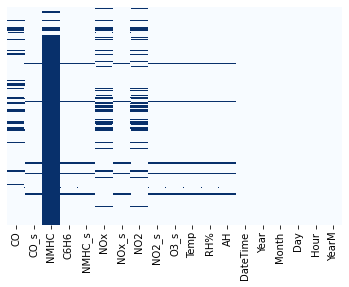

In [ ]:
# Heatmap of NaN values
sns.heatmap(df2.isnull(), yticklabels = False, cbar = False, cmap = 'Blues')

In [ ]:
# Drop NMHC
df2.drop(['NMHC'], axis = 1, inplace = True)

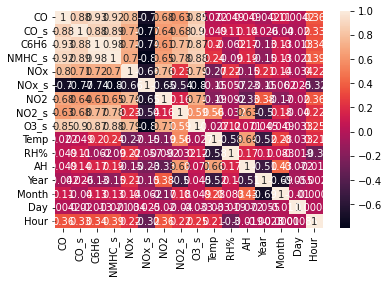

In [ ]:
# Correlation Heat Map
sns.heatmap(df2.corr(), annot = True)

In [ ]:
print(df2.corr())

              CO      CO_s      C6H6    NMHC_s       NOx     NOx_s       NO2  \
CO      1.000000  0.879292  0.931091  0.915519  0.795054 -0.703433  0.683533   
CO_s    0.879292  1.000000  0.883821  0.892972  0.713687 -0.771918  0.641696   
C6H6    0.931091  0.883821  1.000000  0.981962  0.718914 -0.735711  0.614753   
NMHC_s  0.915519  0.892972  0.981962  1.000000  0.704483 -0.796687  0.646520   
NOx     0.795054  0.713687  0.718914  0.704483  1.000000 -0.655690  0.763170   
NOx_s  -0.703433 -0.771918 -0.735711 -0.796687 -0.655690  1.000000 -0.652138   
NO2     0.683533  0.641696  0.614753  0.646520  0.763170 -0.652138  1.000000   
NO2_s   0.630700  0.682874  0.765717  0.777235  0.233777 -0.538460  0.157678   
O3_s    0.854183  0.899326  0.865727  0.880590  0.787056 -0.796554  0.708259   
Temp    0.022113  0.048628  0.198891  0.241330 -0.269713 -0.145133 -0.186369   
RH%     0.048896  0.114607 -0.061643 -0.090352  0.221022 -0.056730 -0.091845   
AH      0.048555  0.135323  0.167909  0.

In [ ]:
# Num of missing in each column
total_missing = df2.isnull().sum()

missing = total_missing > (len(df2)*.3)
missing = total_missing[missing]

# Variables with NaN values > 30% of all obs
print(missing)

#total_missing

Series([], dtype: int64)


In [ ]:
# Find observations with null
#null_obs = []
#for index, row in df2.iterrows():
  #if row.isnull().sum() > len(df2.columns)*.10 :
    #null_obs.append(index)
    #df2 = df2.drop(index, axis=0)
#df22 = df2.drop(null_obs, axis=0)

In [ ]:
## Filling all missing values with medians
# Filling missing value of CO with similar medians according to correlation
index_NaN_CO = np.where(df2['CO'].isnull())[0]

for i in index_NaN_CO :
    CO_med = df2["CO"].median()
    CO_pred = df2["CO"][((df2['CO_s'] == df2.iloc[i]["CO_s"]) & (df2['C6H6'] == df2.iloc[i]["C6H6"]))].median()
    if not np.isnan(CO_pred) :
        df2['CO'].iloc[i] = CO_pred
    else :
        df2['CO'].iloc[i] = CO_med

# Filling missing value of CO_s with similar medians according to correlation
index_NaN_COs = np.where(df2['CO_s'].isnull())[0]

for i in index_NaN_COs:
    COs_med = df2["CO_s"].median()
    COs_pred = df2["CO_s"][((df2['NMHC_s'] == df2.iloc[i]["NMHC_s"]) & (df2['C6H6'] == df2.iloc[i]["C6H6"]))].median()
    if not np.isnan(COs_pred) :
        df2['CO_s'].iloc[i] = COs_pred
    else :
        df2['CO_s'].iloc[i] = COs_med

# Filling missing value of C6H6 with similar medians according to correlation
index_NaN_C6H6 = np.where(df2['C6H6'].isnull())[0]

for i in index_NaN_C6H6 :
    C6H6_med = df2["C6H6"].median()
    C6H6_pred = df2["C6H6"][((df2['NMHC_s'] == df2.iloc[i]["NMHC_s"]) & (df2['CO'] == df2.iloc[i]["CO"]))].median()
    if not np.isnan(C6H6_pred):
        df2['C6H6'].iloc[i] = C6H6_pred
    else :
        df2['C6H6'].iloc[i] = C6H6_med

# Filling missing value of NMHC_s with similar medians according to correlation
index_NaN_NMHC_s = np.where(df2['NMHC_s'].isnull())[0]

for i in index_NaN_NMHC_s :
    NMHC_s_med = df2["NMHC_s"].median()
    NMHC_s_pred = df2["NMHC_s"][((df2['CO'] == df2.iloc[i]["CO"]) & (df2['C6H6'] == df2.iloc[i]["C6H6"]))].median()
    if not np.isnan(NMHC_s_pred) :
        df2['NMHC_s'].iloc[i] = NMHC_s_pred
    else :
        df2['NMHC_s'].iloc[i] = NMHC_s_med

# Filling missing value of NOx with similar medians according to correlation
index_NaN_NOx = np.where(df2['NOx'].isnull())[0]

for i in index_NaN_NOx :
    NOx_med = df2["NOx"].median()
    NOx_pred = df2["NOx"][((df2['O3_s'] == df2.iloc[i]["O3_s"]) & (df2['CO'] == df2.iloc[i]["CO"]))].median()
    if not np.isnan(NOx_pred) :
        df2['NOx'].iloc[i] = NOx_pred
    else :
        df2['NOx'].iloc[i] = NOx_med

# Filling missing value of NOx_s with similar medians according to correlation
index_NaN_NOx_s = np.where(df2['NOx_s'].isnull())[0]

for i in index_NaN_NOx_s :
    NOx_s_med = df2["NOx_s"].median()
    NOx_s_pred = df2["NOx_s"][((df2['O3_s'] == df2.iloc[i]["O3_s"]) & (df2['NMHC_s'] == df2.iloc[i]["NMHC_s"]))].median()
    if not np.isnan(NOx_s_pred) :
        df2['NOx_s'].iloc[i] = NOx_s_pred
    else :
        df2['NOx_s'].iloc[i] = NOx_s_med

# Filling missing value of NO2 with similar medians according to correlation
index_NaN_NO2 = np.where(df2['NO2'].isnull())[0]

for i in index_NaN_NO2 :
    NO2_med = df2["NO2"].median()
    NO2_pred = df2["NO2"][((df2['O3_s'] == df2.iloc[i]["O3_s"]) & (df2['NOx'] == df2.iloc[i]["NOx"]))].median()
    if not np.isnan(NO2_pred) :
        df2['NO2'].iloc[i] = NO2_pred
    else :
        df2['NO2'].iloc[i] = NO2_med

# Filling missing value of NO2_s with similar medians according to correlation
index_NaN_NO2_s = np.where(df2['NO2_s'].isnull())[0]

for i in index_NaN_NO2_s :
    NO2_s_med = df2["NO2_s"].median()
    NO2_s_pred = df2["NO2_s"][((df2['C6H6'] == df2.iloc[i]["C6H6"]) & (df2['NMHC_s'] == df2.iloc[i]["NMHC_s"]))].median()
    if not np.isnan(NO2_s_pred) :
        df2['NO2_s'].iloc[i] = NO2_s_pred
    else :
        df2['NO2_s'].iloc[i] = NO2_s_med

# Filling missing value of O3_s with similar medians according to correlation
index_NaN_O3_s = np.where(df2['O3_s'].isnull())[0]

for i in index_NaN_O3_s :
    O3_s_med = df2["O3_s"].median()
    O3_s_pred = df2["O3_s"][((df2['CO_s'] == df2.iloc[i]["CO_s"]) & (df2['NMHC_s'] == df2.iloc[i]["NMHC_s"]))].median()
    if not np.isnan(O3_s_pred) :
        df2['O3_s'].iloc[i] = O3_s_pred
    else :
        df2['O3_s'].iloc[i] = O3_s_med



In [ ]:
# Filling missing values with median with respective column
df2[['Temp', 'RH%', 'AH']] = df2[['Temp', 'RH%', 'AH']].fillna(df2.median())

In [ ]:
total_missing = df2.isnull().sum()
total_missing

CO          0
CO_s        0
C6H6        0
NMHC_s      0
NOx         0
NOx_s       0
NO2         0
NO2_s       0
O3_s        0
Temp        0
RH%         0
AH          0
DateTime    0
Year        0
Month       0
Day         0
Hour        0
YearM       0
dtype: int64

In [ ]:
df2.dtypes

CO                 float64
CO_s               float64
C6H6               float64
NMHC_s             float64
NOx                float64
NOx_s              float64
NO2                float64
NO2_s              float64
O3_s               float64
Temp               float64
RH%                float64
AH                 float64
DateTime    datetime64[ns]
Year                 int64
Month                int64
Day                  int64
Hour                 int64
YearM               object
dtype: object

In [ ]:
df2.describe()

,CO,CO_s,C6H6,NMHC_s,NOx,NOx_s,NO2,NO2_s,O3_s,Temp,RH%,AH,Year,Month,Day,Hour
count,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000,9357.000000
mean,2.089014,1098.272025,10.010899,937.854610,234.208432,834.202567,112.082163,1452.754417,1020.452175,18.293913,49.244785,1.024351,2004.240141,6.310356,15.876884,11.498557
std,1.323198,212.915093,7.311212,261.622644,195.727709,251.808390,44.235327,339.780850,390.779481,8.659092,16.974420,0.395879,0.427192,3.438160,8.808653,6.923182
min,0.100000,647.250000,0.149048,383.250000,2.000000,322.000000,2.000000,551.000000,221.000000,-1.900000,9.175000,0.184679,2004.000000,1.000000,1.000000,0.000000
25%,1.200000,941.250000,4.591495,742.500000,109.000000,665.500000,84.000000,1241.500000,741.750000,12.025000,36.550000,0.746115,2004.000000,3.000000,8.000000,5.000000
50%,1.800000,1063.000000,8.239851,909.000000,179.800000,805.500000,109.000000,1445.500000,963.250000,17.750000,49.550000,0.995395,2004.000000,6.000000,16.000000,11.000000
75%,2.600000,1221.250000,13.636091,1104.750000,284.900000,960.250000,133.000000,1662.000000,1255.250000,24.075000,61.875000,1.296223,2004.000000,9.000000,23.000000,18.000000
max,11.900000,2039.750000,63.741476,2214.000000,1479.000000,2682.750000,339.700000,2775.000000,2522.750000,44.600000,88.725000,2.231036,2005.000000,12.000000,31.000000,23.000000


# Variable Selection and Plots

              CO      CO_s      C6H6    NMHC_s       NOx     NOx_s       NO2  \
CO      1.000000  0.776955  0.809018  0.795976  0.779696 -0.619338  0.654476   
CO_s    0.776955  1.000000  0.883905  0.892996  0.624126 -0.770514  0.565376   
C6H6    0.809018  0.883905  1.000000  0.981633  0.617404 -0.733513  0.534784   
NMHC_s  0.795976  0.892996  0.981633  1.000000  0.607551 -0.795768  0.563842   
NOx     0.779696  0.624126  0.617404  0.607551  1.000000 -0.573673  0.760423   
NOx_s  -0.619338 -0.770514 -0.733513 -0.795768 -0.573673  1.000000 -0.576457   
NO2     0.654476  0.565376  0.534784  0.563842  0.760423 -0.576457  1.000000   
NO2_s   0.543778  0.683310  0.766283  0.777192  0.195657 -0.536522  0.136798   
O3_s    0.763579  0.899419  0.865758  0.880645  0.696027 -0.795316  0.631537   
Temp    0.006040  0.049020  0.199257  0.241533 -0.245931 -0.144791 -0.168014   
RH%     0.041033  0.114421 -0.061747 -0.090409  0.182285 -0.056798 -0.083787   
AH      0.022912  0.135726  0.168411  0.

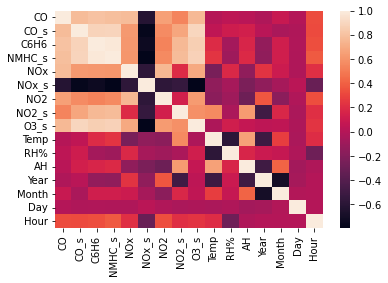

In [ ]:
# New correlation
print(df2.corr())

# Correlation Heat Map
sns.heatmap(df2.corr())

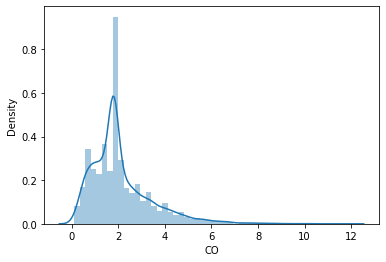

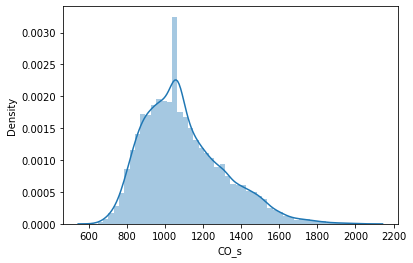

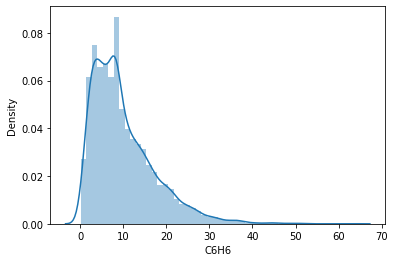

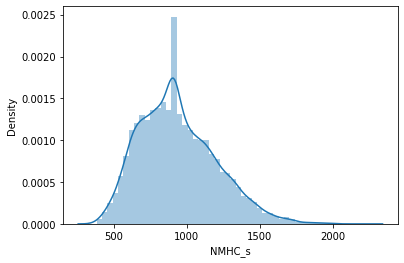

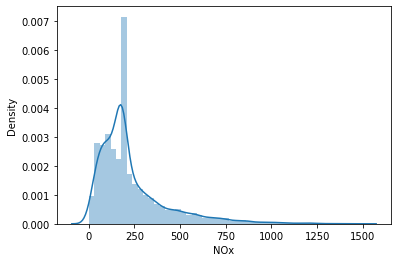

...

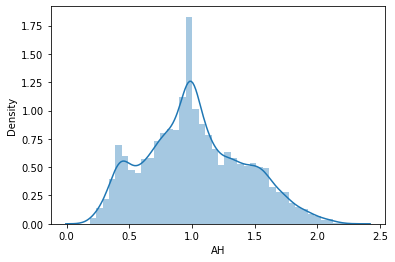

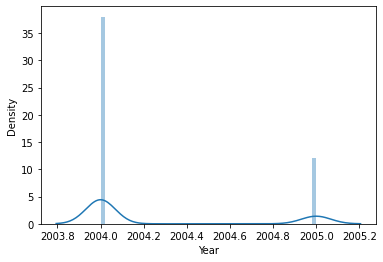

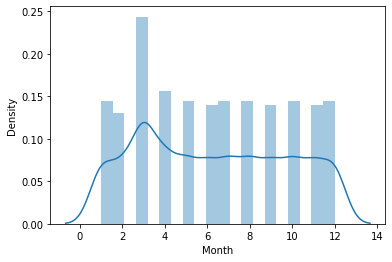

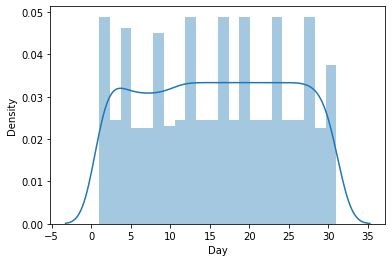

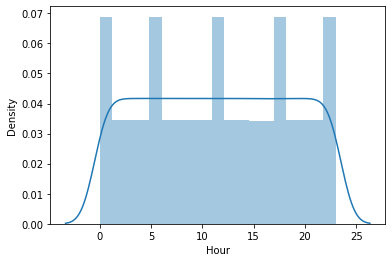

In [ ]:
# DF without time/date
df3 = df2.select_dtypes(exclude = ['object', 'datetime64[ns]'])

# Distributions for each variable
for column in df3.columns:
    plt.figure()
    sns.distplot(df3[column])

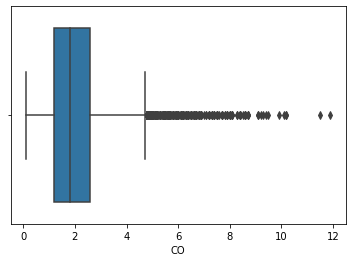

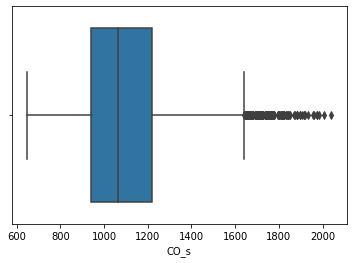

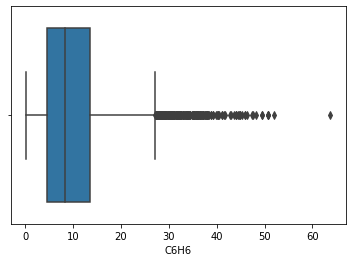

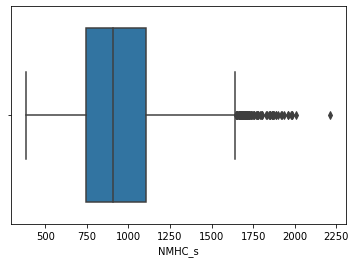

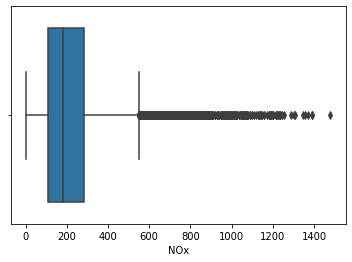

...

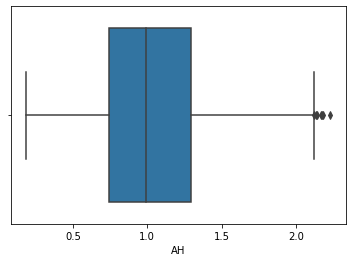

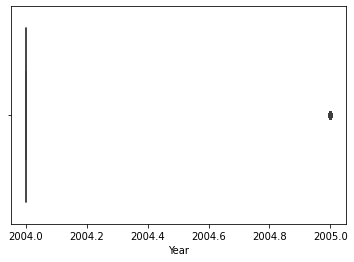

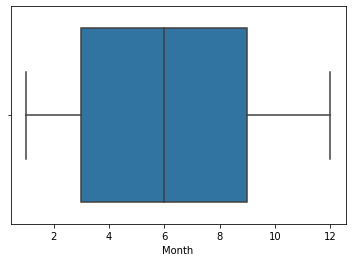

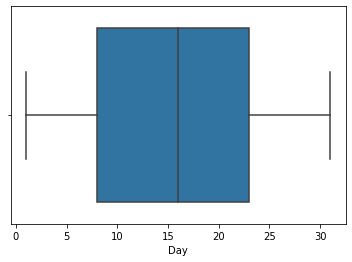

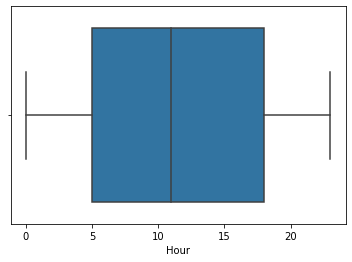

In [ ]:
# Distributions for each variable
for column in df3.columns:
    plt.figure()
    sns.boxplot(df3[column])

<Figure size 432x288 with 0 Axes>

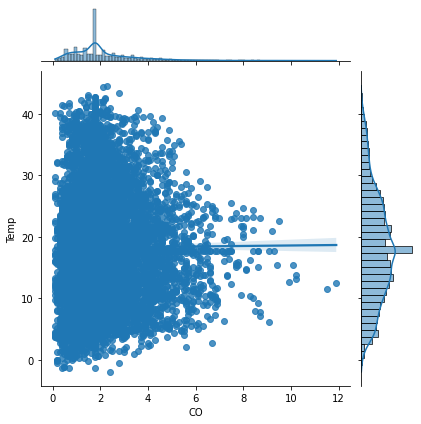

<Figure size 432x288 with 0 Axes>

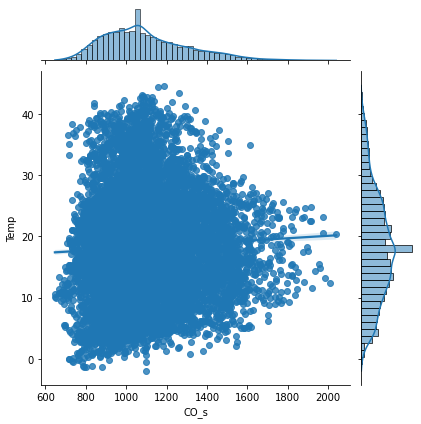

<Figure size 432x288 with 0 Axes>

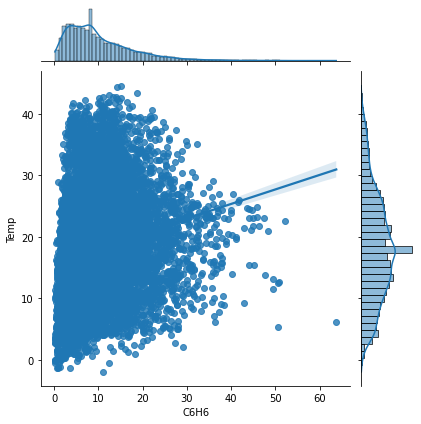

<Figure size 432x288 with 0 Axes>

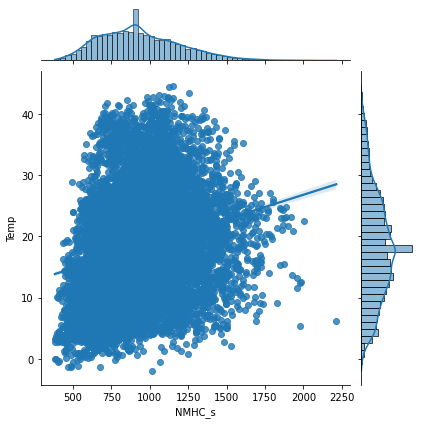

<Figure size 432x288 with 0 Axes>

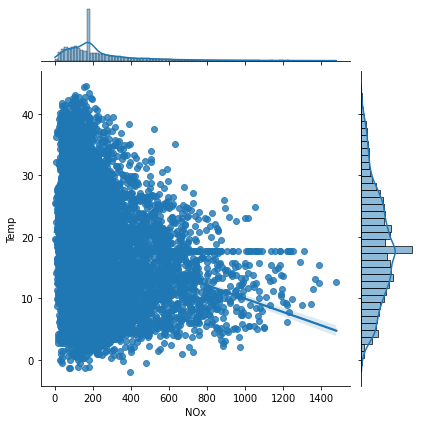

<Figure size 432x288 with 0 Axes>

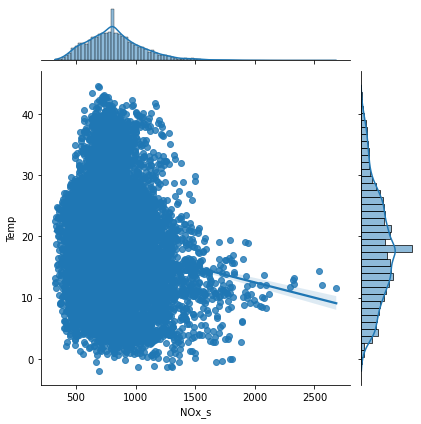

<Figure size 432x288 with 0 Axes>

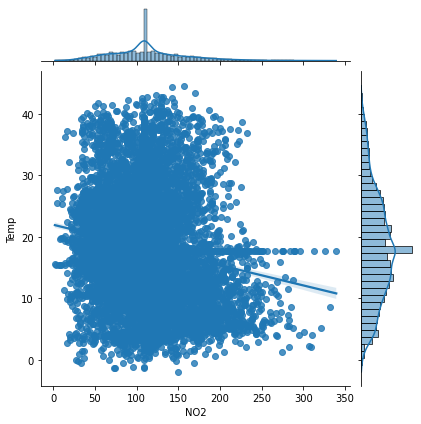

<Figure size 432x288 with 0 Axes>

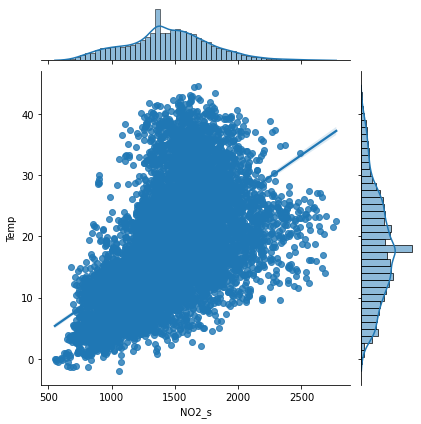

<Figure size 432x288 with 0 Axes>

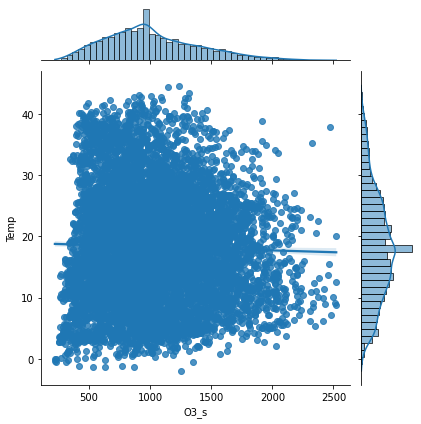

<Figure size 432x288 with 0 Axes>

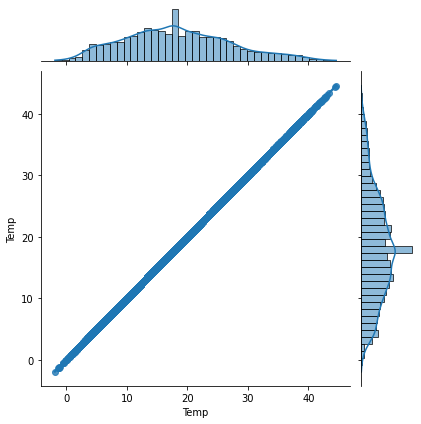

<Figure size 432x288 with 0 Axes>

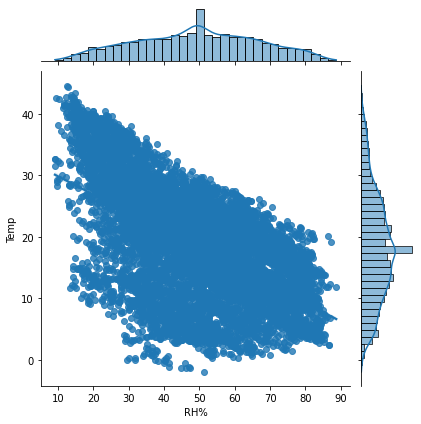

<Figure size 432x288 with 0 Axes>

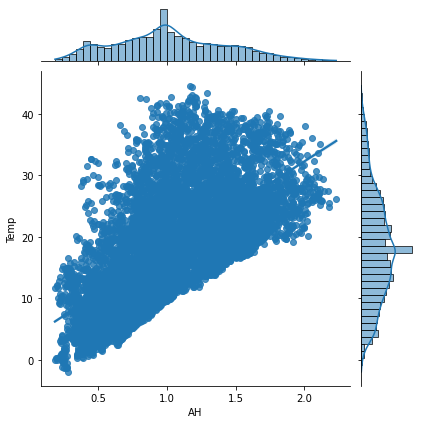

<Figure size 432x288 with 0 Axes>

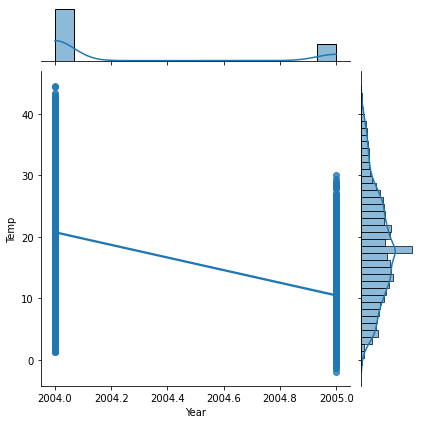

<Figure size 432x288 with 0 Axes>

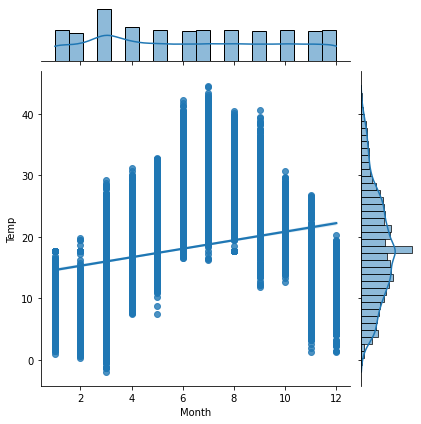

<Figure size 432x288 with 0 Axes>

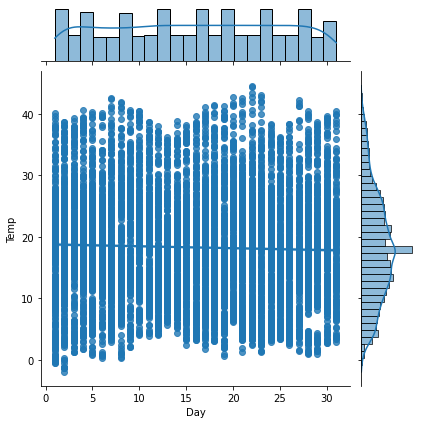

<Figure size 432x288 with 0 Axes>

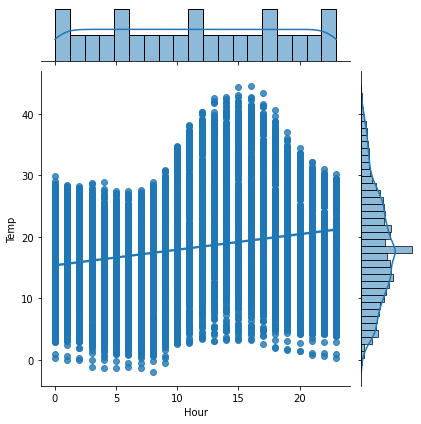

In [ ]:
# Linear plot with temp against all variables
for column in df3.columns:
    plt.figure()
    sns.jointplot(x = column, y = 'Temp', data = df3, kind = 'reg')

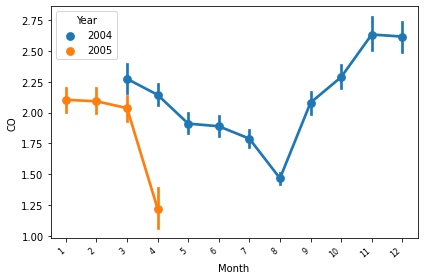

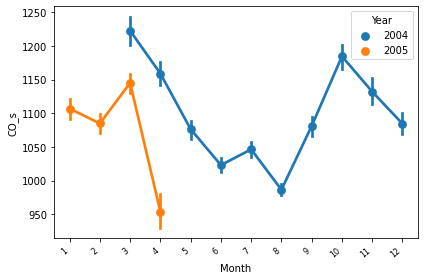

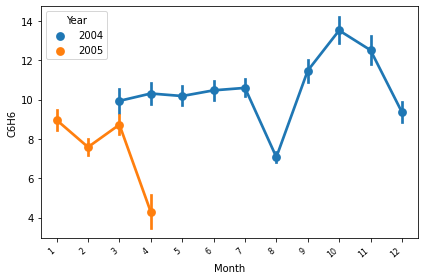

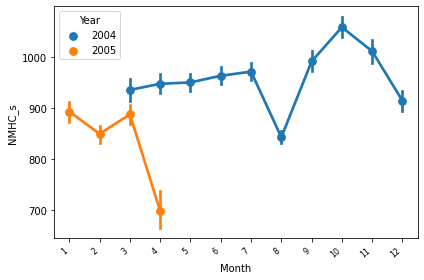

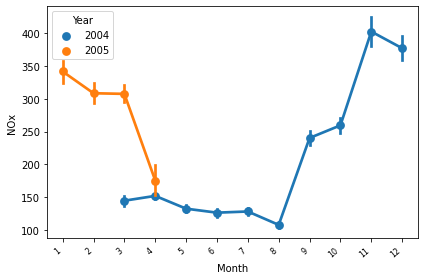

...

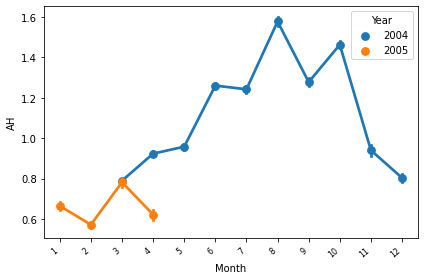

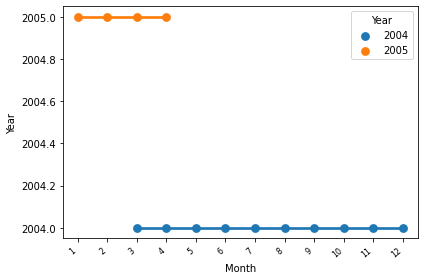

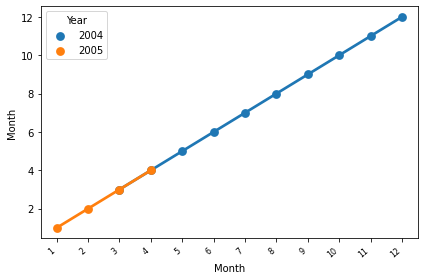

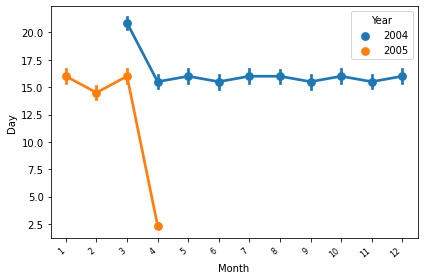

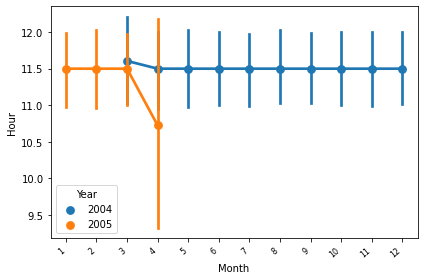

In [ ]:
# Gas Concentrations across each month in both years
for column in df3.columns:
    plt.figure()
    ax = sns.pointplot(x = "Month", y = column, hue = "Year", data = df3)
    ax.set_xticklabels(ax.get_xticklabels(), rotation = 40, ha = "right", fontsize = 8)
    plt.tight_layout()
    plt.show()

<Figure size 432x288 with 0 Axes>

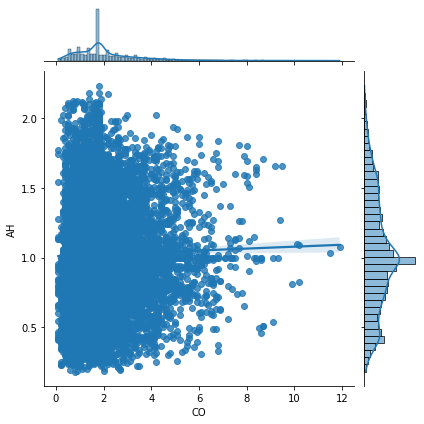

<Figure size 432x288 with 0 Axes>

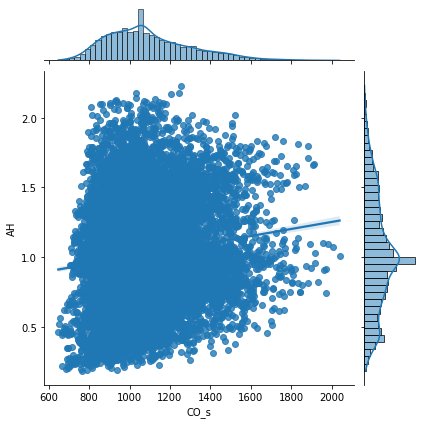

<Figure size 432x288 with 0 Axes>

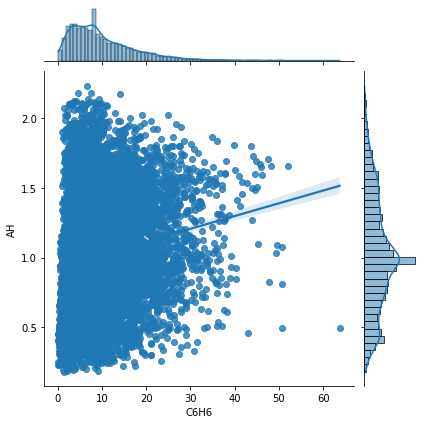

<Figure size 432x288 with 0 Axes>

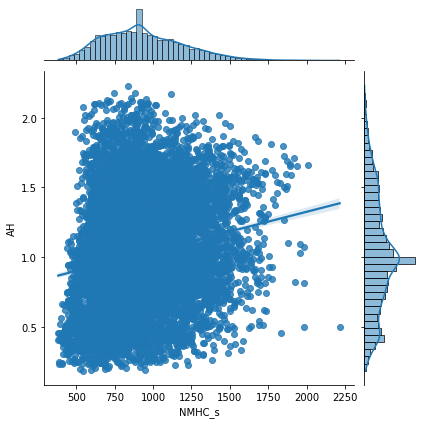

<Figure size 432x288 with 0 Axes>

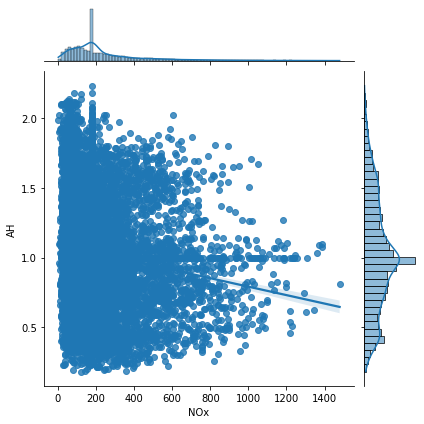

<Figure size 432x288 with 0 Axes>

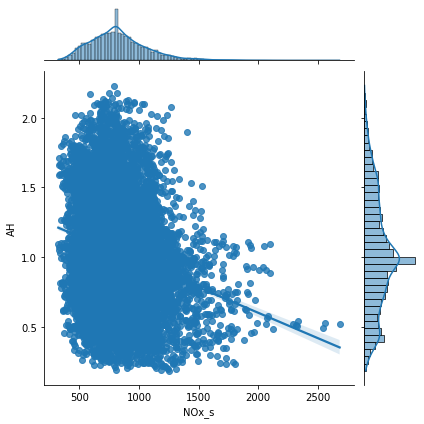

<Figure size 432x288 with 0 Axes>

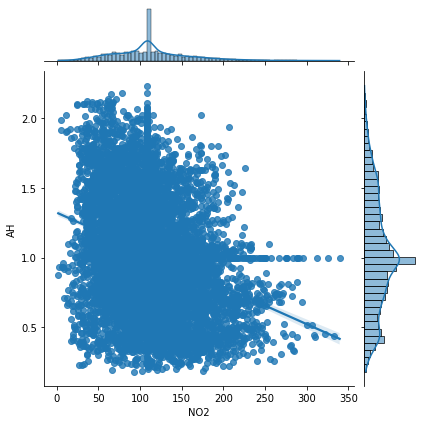

<Figure size 432x288 with 0 Axes>

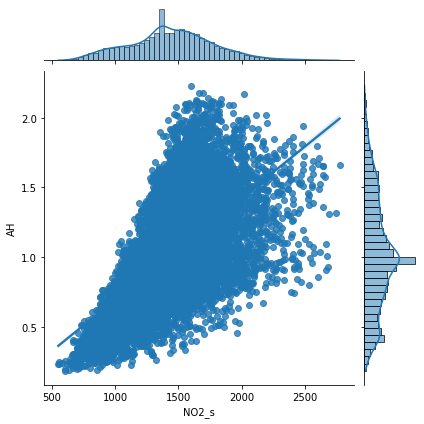

<Figure size 432x288 with 0 Axes>

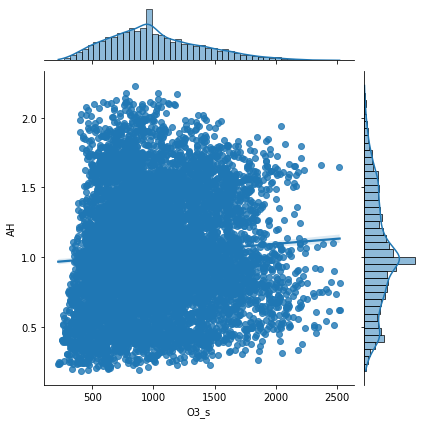

<Figure size 432x288 with 0 Axes>

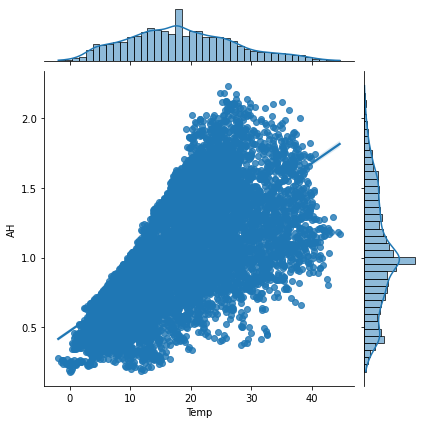

<Figure size 432x288 with 0 Axes>

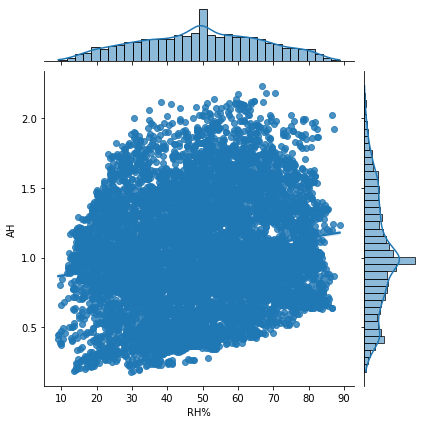

<Figure size 432x288 with 0 Axes>

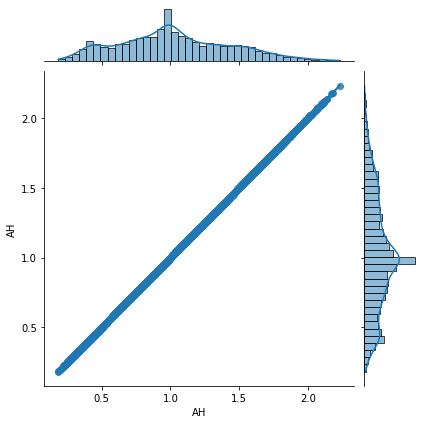

<Figure size 432x288 with 0 Axes>

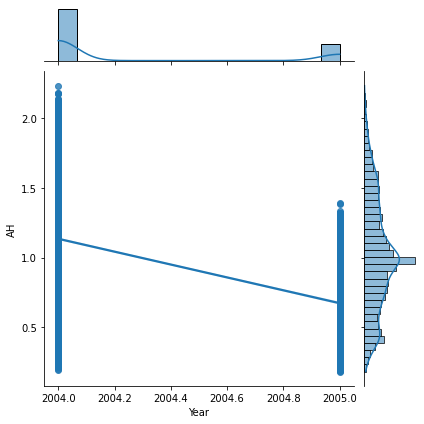

<Figure size 432x288 with 0 Axes>

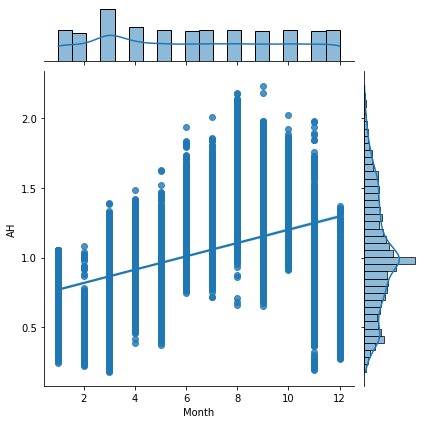

<Figure size 432x288 with 0 Axes>

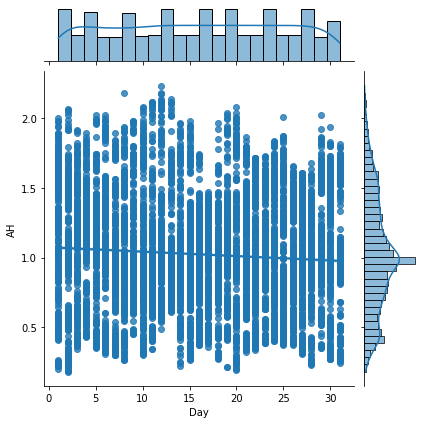

<Figure size 432x288 with 0 Axes>

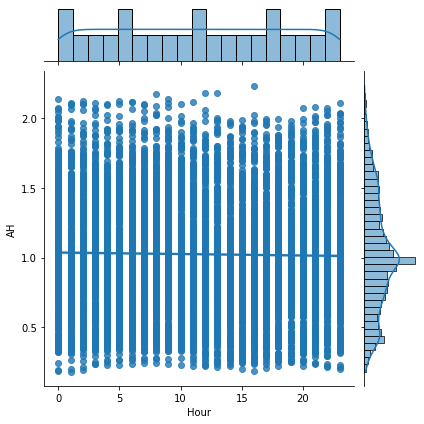

In [ ]:
# Plot with AH against all variables
for column in df3.columns:
    plt.figure()
    sns.jointplot(x = column, y = 'AH', data = df3, kind = 'reg')

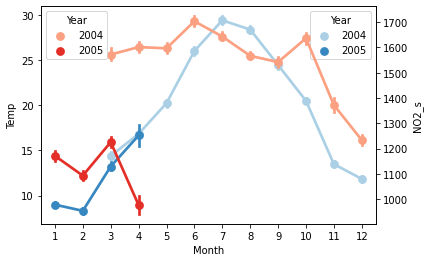

In [ ]:
# Combined plot of Temp and NO2_s vs date
fig, ax = plt.subplots()
sns.pointplot(x = "Month", y = 'Temp', hue = "Year", data = df3, palette = 'Blues')
ax2 = ax.twinx()
sns.pointplot(x = "Month", y = 'NO2_s', hue = "Year", data = df3, palette = 'Reds')

plt.show()

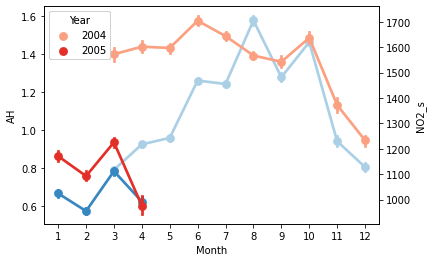

In [ ]:
# Combined plot of AH and NO2_s vs date
fig, ax2 = plt.subplots()
sns.pointplot(x = "Month", y = 'AH', hue = "Year", data = df3, palette = 'Blues')
ax3 = ax2.twinx()
sns.pointplot(x = "Month", y = 'NO2_s', hue = "Year", data = df3, palette = 'Reds')

plt.show()

# Linear Regression - Temperature OLS

Temp = 0.4277911583087839 + 0.10486557 * NO2_s - 0.03218797 * NOx - 0.59544465 * RH% + 0.66706038 * AH - 0.01989868 * Year

In [ ]:
# Scale dataframe
mm = MinMaxScaler()
df_scaled = pd.DataFrame(mm.fit_transform(df3), columns = df3.columns)
print(df_scaled)
print(df_scaled.describe())
print(df_scaled.corr())

            CO      CO_s      C6H6    NMHC_s       NOx     NOx_s       NO2  \
0     0.211864  0.511849  0.184498  0.361737  0.111036  0.311024  0.328694   
1     0.161017  0.463196  0.145428  0.312167  0.068382  0.360796  0.266509   
2     0.177966  0.542011  0.139148  0.303701  0.087339  0.346500  0.331655   
3     0.177966  0.522980  0.142780  0.308617  0.115098  0.326168  0.355345   
4     0.127119  0.448833  0.100156  0.247030  0.087339  0.374034  0.337578   
...        ...       ...       ...       ...       ...       ...       ...   
9352  0.254237  0.478995  0.210411  0.392189  0.318009  0.091708  0.556115   
9353  0.194915  0.370018  0.176218  0.351632  0.237847  0.119348  0.524726   
9354  0.194915  0.355296  0.192248  0.371023  0.197021  0.119136  0.511401   
9355  0.169492  0.255117  0.147787  0.315308  0.157414  0.160754  0.455138   
9356  0.177966  0.304129  0.185290  0.362693  0.178199  0.140633  0.490672   

         NO2_s      O3_s      Temp       RH%        AH  Year   

In [ ]:
# Define X and Y
X = df_scaled[['NO2_s', 'NOx', 'RH%', 'AH', 'Year']]
Y = df_scaled['Temp']

#X

In [ ]:
s = StandardScaler()

In [ ]:
# Create testing and training data
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size = 0.25, random_state = 10)
print(X_train.shape)
print(X_test.shape)
print(Y_train.shape)
print(Y_test.shape)


(7017, 5)
(2340, 5)
(7017,)
(2340,)


In [ ]:
# Fit linear model
lin_model = LinearRegression()
lin_model.fit(X_train, Y_train)

LinearRegression()

In [ ]:
# Evaluation for Training
y_train_predict = lin_model.predict(X_train)
rmse = (np.sqrt(mean_squared_error(Y_train, y_train_predict)))
r2 = r2_score(Y_train, y_train_predict)

print("The model performance for training set")
print("--------------------------------------")
print('RMSE is {}'.format(rmse))
print('R2 score is {}'.format(r2))
print("\n")

# Evaluation for Testing
y_test_predict = lin_model.predict(X_test)
rmse = (np.sqrt(mean_squared_error(Y_test, y_test_predict)))
r2 = r2_score(Y_test, y_test_predict)

print("The model performance for testing set")
print("--------------------------------------")
print('RMSE is {}'.format(rmse))
print('R2 score is {}'.format(r2))


The model performance for training set
--------------------------------------
RMSE is 0.050599935913462644
R2 score is 0.9268167915186268


The model performance for testing set
--------------------------------------
RMSE is 0.05082055659028527
R2 score is 0.9234431750805177


In [ ]:
# OLS Summary
X_train_off = sm.add_constant(X_train)
smRegression = sm.OLS(Y_train, X_train_off)

model = smRegression.fit()
print(model.summary())

                            OLS Regression Results                            
Dep. Variable:                   Temp   R-squared:                       0.927
Model:                            OLS   Adj. R-squared:                  0.927
Method:                 Least Squares   F-statistic:                 1.776e+04
Date:                Sat, 12 Nov 2022   Prob (F-statistic):               0.00
Time:                        03:44:41   Log-Likelihood:                 10981.
No. Observations:                7017   AIC:                        -2.195e+04
Df Residuals:                    7011   BIC:                        -2.191e+04
Df Model:                           5                                         
Covariance Type:            nonrobust                                         
                 coef    std err          t      P>|t|      [0.025      0.975]
------------------------------------------------------------------------------
const          0.4278      0.003    166.634      0.0

In [ ]:
print(lin_model.coef_)
print(lin_model.intercept_)

[ 0.10486557 -0.03218797 -0.59544465  0.66706038 -0.01989868]
0.4277911583087839


# SGDRegression - Temp

In [ ]:
# Hypertune parameters
sgdr = SGDRegressor(alpha = 0.0025, epsilon = 0.09, eta0 = 0.1,
                    max_iter = 10000, penalty = 'elasticnet', )

In [ ]:
sgdr.fit(X_train, Y_train)

SGDRegressor(alpha=0.0025, epsilon=0.09, eta0=0.1, max_iter=10000,
             penalty='elasticnet')

In [ ]:
score = sgdr.score(X_train, Y_train)
print("R-squared:", score)

R-squared: 0.9203604924840493


MSE:  0.0027671436781055367
RMSE:  0.052603647003848855


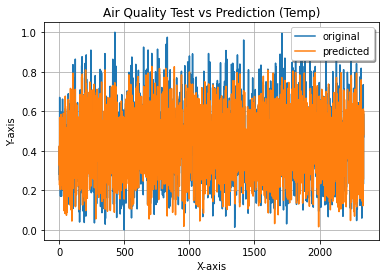

In [ ]:
ypred = sgdr.predict(X_test)

# Calculate MSE and RMSE
mse = mean_squared_error(Y_test, ypred)
print("MSE: ", mse)
print("RMSE: ", mse**(1/2.0))

x_ax = range(len(Y_test))
plt.plot(x_ax, Y_test, label = "original")
plt.plot(x_ax, ypred, label = "predicted")
plt.title("Air Quality Test vs Prediction (Temp)")
plt.xlabel('X-axis')
plt.ylabel('Y-axis')
plt.legend(loc = 'best', fancybox = True, shadow = True)
plt.grid(True)
plt.show()

#  Decision Tree Regressor - Temp

In [ ]:
df3.round(decimals = 5)

,CO,CO_s,C6H6,NMHC_s,NOx,NOx_s,NO2,NO2_s,O3_s,Temp,RH%,AH,Year,Month,Day,Hour
0,2.6,1360.00,11.88172,1045.50,166.0,1056.25,113.0,1692.00,1267.50,13.600,48.875,0.75775,2004,3,10,18
1,2.0,1292.25,9.39716,954.75,103.0,1173.75,92.0,1558.75,972.25,13.300,47.700,0.72549,2004,3,10,19
2,2.2,1402.00,8.99782,939.25,131.0,1140.00,114.0,1554.50,1074.00,11.900,53.975,0.75024,2004,3,10,20
3,2.2,1375.50,9.22880,948.25,172.0,1092.00,122.0,1583.75,1203.25,11.000,60.000,0.78671,2004,3,10,21
4,1.6,1272.25,6.51822,835.50,131.0,1205.00,116.0,1490.00,1110.00,11.150,59.575,0.78879,2004,3,10,22
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
9352,3.1,1314.25,13.52960,1101.25,471.7,538.50,189.8,1374.25,1728.50,21.850,29.250,0.75682,2005,4,4,10
9353,2.4,1162.50,11.35516,1027.00,353.3,603.75,179.2,1263.50,1269.00,24.325,23.725,0.71186,2005,4,4,11
9354,2.4,1142.00,12.37454,1062.50,293.0,603.25,174.7,1240.75,1092.00,26.900,18.350,0.64065,2005,4,4,12
9355,2.1,1002.50,9.54719,960.50,234.5,701.50,155.7,1041.00,769.75,28.325,13.550,0.51387,2005,4,4,13


In [ ]:
# Define X and Y
X = df_scaled[['NO2_s', 'NOx', 'RH%', 'AH', 'Year']]
Y = df_scaled['Temp']

X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size = 0.4, random_state = 10)

# Creating and fitting regressor
regressor = DecisionTreeRegressor()
regressor.fit(X_train, Y_train)

DecisionTreeRegressor()

In [ ]:
# Predicting metrics
predictions = regressor.predict(X_test)

print("R2 square = ", r2_score(Y_test, predictions))
print("MSE = ", mean_squared_error(Y_test, predictions))
print("MAE = ", mean_absolute_error(Y_test, predictions))
print("Explained variance score = ", explained_variance_score(Y_test, predictions))

R2 square =  0.9955881467566917
MSE =  0.00015241492672631352
MAE =  0.007083473385803944
Explained variance score =  0.9955881495999834


In [ ]:
# Tree with base parameters
dot_data = tree.export_graphviz(regressor, out_file = None,
                                feature_names = X.columns,
                                class_names = Y.unique(),
                                filled = True, rounded = True,
                                special_characters = True)
graph = graphviz.Source(dot_data)
graph

In [ ]:
#fig = plt.figure(figsize=(25,20))
#dot_data = dtreeviz(regressor, X_train, Y_train,
#                                feature_names = X.columns,
#                                target_name = Y.unique())
#dot_data

In [ ]:
# Fine tuning DecisionTreeRegressor()
dt_pipe = Pipeline([('mms', MinMaxScaler()),
                     ('dt', DecisionTreeRegressor())])
params = [{'dt__max_depth': [3, 5, 10, 15],
         'dt__min_samples_leaf': [2, 3, 5]}]

gs_dt = GridSearchCV(dt_pipe,
                     param_grid = params,
                     scoring = 'r2',
                     cv = 5)
gs_dt.fit(X, Y)
print(gs_dt.best_params_)

# Find best model score
print('R2:', gs_dt.score(X, Y))

{'dt__max_depth': 15, 'dt__min_samples_leaf': 2}
R2: 0.9997975408392739


In [ ]:
# Tree with fine tuned parameters
regressor1 = DecisionTreeRegressor(max_depth = 15, min_samples_leaf = 2)
regressor1.fit(X_train, Y_train)

dot_data = tree.export_graphviz(regressor1, out_file = None,
                                feature_names = X.columns,
                                class_names = Y.unique(),
                                filled = True, rounded = True,
                                special_characters = True)
graph = graphviz.Source(dot_data)
graph

In [ ]:
# Predicting metrics after optimization
predictions = gs_dt.predict(X_test)

print("R2 square = ", r2_score(Y_test, predictions))
print("MSE = ", mean_squared_error(Y_test, predictions))
print("MAE = ", mean_absolute_error(Y_test, predictions))
print("Explained variance score = ", explained_variance_score(Y_test, predictions))

R2 square =  0.9997943435966641
MSE =  7.104748031403125e-06
MAE =  0.0015515799280888605
Explained variance score =  0.9997943577660877


# Random Forest Regressor - Temp



In [ ]:
# Create and fit RF regressor
rf = RandomForestRegressor()
rf.fit(X_train, Y_train)

RandomForestRegressor()

In [ ]:
# Predict metrics using base parameters
predictions = rf.predict(X_test)

print("R2 square = ", r2_score(Y_test, predictions))
print("MSE = ", mean_squared_error(Y_test, predictions))
print("MAE = ", mean_absolute_error(Y_test, predictions))
print("Explained variance score = ", explained_variance_score(Y_test, predictions))


R2 square =  0.9988448860223843
MSE =  3.990536460519612e-05
MAE =  0.0029664320632300186
Explained variance score =  0.9988449147717658


In [ ]:
params = {'max_depth': [3, 5, 10, 15],
          'n_estimators': [50, 150, 250]}
#scoring = ['r2', 'explained_variance', 'max_error', 'neg_mean_absolute_error', 'neg_mean_squared_error']
grid = GridSearchCV(rf, params, cv = 5, scoring = 'r2', return_train_score = False)
grid.fit(X, Y)

print(grid.best_params_)
# Find best model score
print('R2:', grid.score(X, Y))

{'max_depth': 15, 'n_estimators': 150}
R2: 0.9999163729826821


In [ ]:
y_predictions = grid.predict(X_test)

print("R2 square = ", r2_score(Y_test, predictions))
print("MSE = ", mean_squared_error(Y_test, predictions))
print("MAE = ", mean_absolute_error(Y_test, predictions))
print("Explained variance score = ", explained_variance_score(Y_test, predictions))

R2 square =  0.9988448860223843
MSE =  3.990536460519612e-05
MAE =  0.0029664320632300186
Explained variance score =  0.9988449147717658


# AdaBoost Regressor - Temp

In [ ]:
# Create and fitAdaBoost regressor
adab = AdaBoostRegressor()
adab.fit(X_train, Y_train)

AdaBoostRegressor()

In [ ]:
# Make predictions based on AdaBoost predictions
predictions = adab.predict(X_test)

print("R2 square = ", r2_score(Y_test, predictions))
print("MSE = ", mean_squared_error(Y_test, predictions))
print("MAE = ", mean_absolute_error(Y_test, predictions))
print("Explained variance score = ", explained_variance_score(Y_test, predictions))

R2 square =  0.9353614441922378
MSE =  0.0022330481554611666
MAE =  0.03696795909763163
Explained variance score =  0.936520983676949


In [ ]:
# Tune parameters
params = {'n_estimators':[50, 150, 250],
         'learning_rate':[.001, 0.01, .1, 1],
          'random_state':[5]}

grid1 = GridSearchCV(adab, params, scoring = 'r2', cv = 5)
grid1.fit(X, Y)

print(grid1.best_params_)
# Find best model score
print('R2:', grid1.score(X, Y))

{'learning_rate': 1, 'n_estimators': 250, 'random_state': 5}
R2: 0.9559788760130207


In [ ]:
# Predictions using tuned parameters
predictions = grid1.predict(X_test)

print("R2 square = ", r2_score(Y_test, predictions))
print("MSE = ", mean_squared_error(Y_test, predictions))
print("MAE = ", mean_absolute_error(Y_test, predictions))
print("Explained variance score = ", explained_variance_score(Y_test, predictions))

R2 square =  0.9552090566436059
MSE =  0.0015473788390450117
MAE =  0.03052039462968603
Explained variance score =  0.957442602508879


# XGBoost Regressor - Temp

In [ ]:
xgb1 = xgb.XGBRegressor()
xgb1.fit(X_train, Y_train)

[03:46:32] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.


XGBRegressor()

In [ ]:
# Predictions before tuning
predictions = xgb1.predict(X_test)

print("R2 square = ", r2_score(Y_test, predictions))
print("MSE = ", mean_squared_error(Y_test, predictions))
print("MAE = ", mean_absolute_error(Y_test, predictions))
print("Explained variance score = ", explained_variance_score(Y_test, predictions))

R2 square =  0.9961906013941076
MSE =  0.0001316021130732426
MAE =  0.008350957293223644
Explained variance score =  0.9961918623050173


In [ ]:
xgb_model = xgb.XGBRegressor(n_jobs = multiprocessing.cpu_count() // 2)
clf = GridSearchCV(xgb_model, {'max_depth': [3, 5, 10, 15], 'n_estimators': [50, 150, 250]},
                   verbose = 2, n_jobs = 2, cv = 10)
clf.fit(X, Y)
print(clf.best_score_)
print(clf.best_params_)

Fitting 10 folds for each of 12 candidates, totalling 120 fits
[03:48:20] WARNING: /workspace/src/objective/regression_obj.cu:152: reg:linear is now deprecated in favor of reg:squarederror.
0.994374631065743
{'max_depth': 5, 'n_estimators': 250}


In [ ]:
# Predictions using tuned parameters
predictions = clf.predict(X_test)

print("R2 square = ", r2_score(Y_test, predictions))
print("MSE = ", mean_squared_error(Y_test, predictions))
print("MAE = ", mean_absolute_error(Y_test, predictions))
print("Explained variance score = ", explained_variance_score(Y_test, predictions))

R2 square =  0.999643937867938
MSE =  1.230076812970937e-05
MAE =  0.002612476017285798
Explained variance score =  0.9996439814632008


# Classification Metrics - Decision Tree

In [ ]:
# Transform Temp into a categorical variable
df3.describe()['Temp']
subTemp = pd.cut(df3.Temp, bins = [-2, 12.025000, 17.750000, 24.075000, 50],
                 labels = ['Min', '25%', '50%', '75% +'])

In [ ]:
df3.insert(9, 'TempGroup', subTemp)

In [ ]:
df3['TempGroup'].value_counts(normalize = True)

25%      0.269851
Min      0.250401
75% +    0.249653
50%      0.230095
Name: TempGroup, dtype: float64

In [ ]:
# Create X, Y
featureCol = ['NO2_s', 'NOx', 'RH%', 'AH', 'Year']
X = df3[featureCol]
Y = df3.TempGroup

In [ ]:
# Set training and testing parameters
X_train, X_test, Y_train, Y_test = train_test_split(X, Y, test_size = 0.3, random_state = 1)

# Define and fit classifier
clf = DecisionTreeClassifier()
clf.fit(X_train, Y_train)

DecisionTreeClassifier()

In [ ]:
# Predictions before optimizing
predictions = clf.predict(X_test)
predicted_probas = clf.predict_proba(X_test)

print(classification_report(Y_test, predictions))
print('Predicted labels: ', predictions)
print('Accuracy: ', accuracy_score(Y_test, predictions))

              precision    recall  f1-score   support

         25%       0.96      0.96      0.96       714
         50%       0.96      0.95      0.95       652
       75% +       0.98      0.98      0.98       728
         Min       0.99      0.97      0.98       714

    accuracy                           0.97      2808
   macro avg       0.97      0.97      0.97      2808
weighted avg       0.97      0.97      0.97      2808

Predicted labels:  ['Min' 'Min' 'Min' ... '25%' '50%' '75% +']
Accuracy:  0.9697293447293447


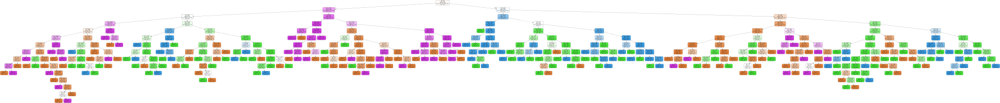

In [ ]:
# Tree with base parameters
dot_data = tree.export_graphviz(clf, out_file = None,
                                feature_names = X.columns,
                                class_names = Y.unique(),
                                filled = True, rounded = True,
                                special_characters = True)
graph = graphviz.Source(dot_data)
graph

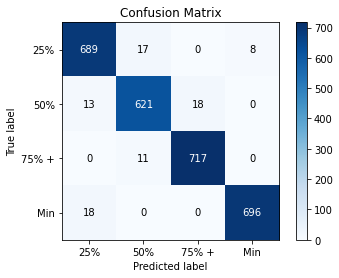

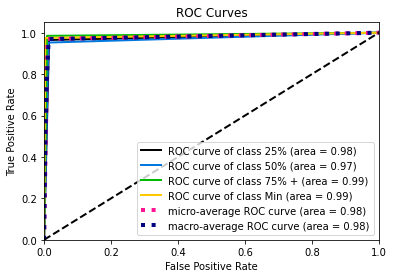

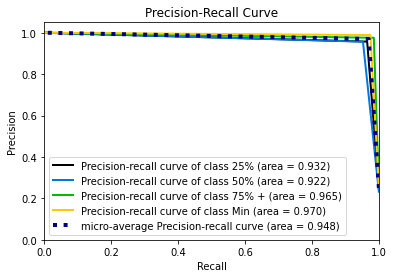

In [ ]:
# Matrix, ROC, precision-recall before optimizing
skplt.metrics.plot_confusion_matrix(Y_test, predictions)
skplt.metrics.plot_roc(Y_test, predicted_probas)
skplt.metrics.plot_precision_recall_curve(Y_test, predicted_probas)
plt.show()

In [ ]:
#Hypertune parameters
dt_pipe = Pipeline([('mms', MinMaxScaler()), ('dt', DecisionTreeClassifier())])
params = [{'dt__max_depth': [5, 10, 12, 15], 'dt__min_samples_leaf': [2, 3, 5]}]

gs_dt = GridSearchCV(dt_pipe, param_grid = params, scoring = 'accuracy', cv = 5)
gs_dt.fit(X, Y)

# Print results
print(gs_dt.best_params_)
print(gs_dt.score(X, Y))

{'dt__max_depth': 15, 'dt__min_samples_leaf': 3}
0.9926258416159025


In [ ]:
predictions = gs_dt.predict(X_test)
predicted_probas = gs_dt.predict_proba(X_test)

print(classification_report(Y_test, predictions))
print('Predicted labels: ', predictions)
print('Accuracy: ', accuracy_score(Y_test, predictions))

              precision    recall  f1-score   support

         25%       0.99      1.00      0.99       714
         50%       0.99      0.99      0.99       652
       75% +       1.00      1.00      1.00       728
         Min       1.00      0.99      1.00       714

    accuracy                           0.99      2808
   macro avg       0.99      0.99      0.99      2808
weighted avg       0.99      0.99      0.99      2808

Predicted labels:  ['Min' 'Min' '25%' ... '25%' '50%' '75% +']
Accuracy:  0.9946581196581197


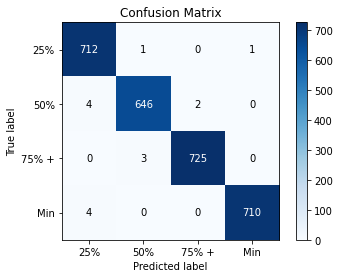

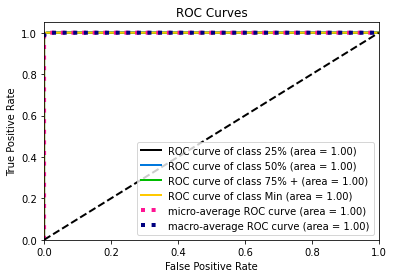

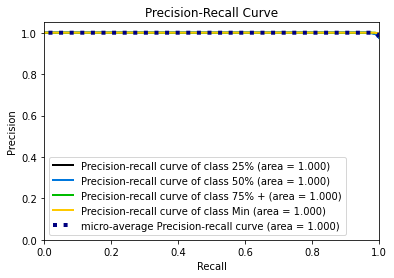

In [ ]:
# Matrix, ROC, precision-recall before optimizing
skplt.metrics.plot_confusion_matrix(Y_test, predictions)
skplt.metrics.plot_roc(Y_test, predicted_probas)
skplt.metrics.plot_precision_recall_curve(Y_test, predicted_probas)
plt.show()

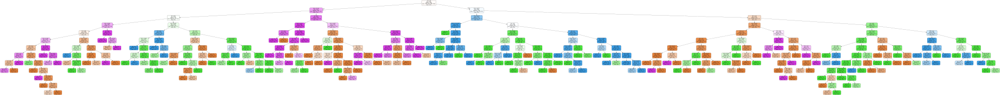

In [ ]:
# Tree with optimized parameters
dt2 = DecisionTreeClassifier(min_samples_leaf = 3, max_depth = 12)
clf2 = dt2.fit(X_train, Y_train)

# Tree with base parameters
dot_data = tree.export_graphviz(clf2, out_file = None,
                                feature_names = X.columns,
                                class_names = Y.unique(),
                                filled = True, rounded = True,
                                special_characters = True)
graph = graphviz.Source(dot_data)
graph

# Classification Metrics - Random Forest

In [ ]:
# Create and fit classifier
rf = RandomForestClassifier()
clf1 = rf.fit(X_train, Y_train)

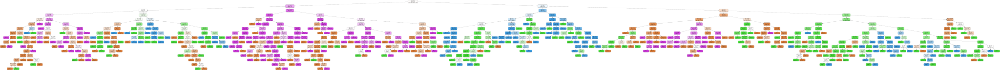

In [ ]:
# Prior to optimizing
dot_data = export_graphviz(clf1.estimators_[0],
                feature_names=X.columns,
                filled=True,
                rounded=True)

graph = graphviz.Source(dot_data)
graph

In [ ]:
# Predictions before optimization
predictions = rf.predict(X_test)
predicted_probas = rf.predict_proba(X_test)

print(classification_report(Y_test, predictions))
print('Predicted labels: ', predictions)
print('Accuracy: ', accuracy_score(Y_test, predictions))

              precision    recall  f1-score   support

         25%       0.95      0.96      0.96       714
         50%       0.95      0.96      0.95       652
       75% +       0.98      0.98      0.98       728
         Min       0.98      0.97      0.98       714

    accuracy                           0.97      2808
   macro avg       0.97      0.97      0.97      2808
weighted avg       0.97      0.97      0.97      2808

Predicted labels:  ['Min' 'Min' 'Min' ... '25%' '50%' '75% +']
Accuracy:  0.967948717948718


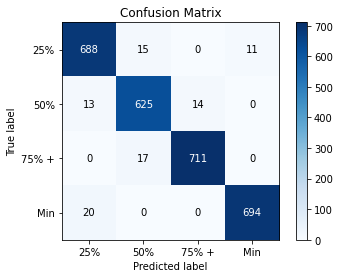

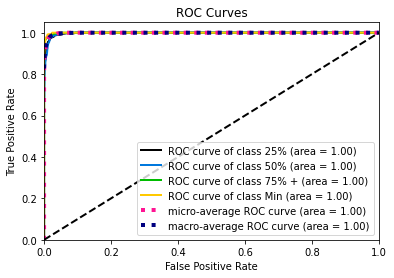

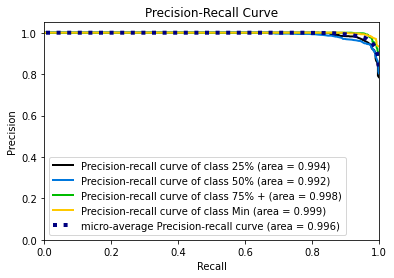

In [ ]:
skplt.metrics.plot_confusion_matrix(Y_test, predictions)
skplt.metrics.plot_roc(Y_test, predicted_probas)
skplt.metrics.plot_precision_recall_curve(Y_test, predicted_probas)
plt.show()

In [ ]:
# Optimize parameters
grid = GridSearchCV(rf, {'max_depth': [5, 10, 12, 15],
          'n_estimators': [50, 150, 250],
          'max_features': ['sqrt', 'log2']}, scoring = 'accuracy', return_train_score = False)

grid.fit(X, Y)

# Print results
print(grid.best_params_)
print(grid.score(X, Y))

{'max_depth': 15, 'max_features': 'log2', 'n_estimators': 250}
1.0


In [ ]:
# Predictions before optimization
predictions = grid.predict(X_test)

print(classification_report(Y_test, predictions))
print('Predicted labels: ', predictions)
print('Accuracy: ', accuracy_score(Y_test, predictions))

              precision    recall  f1-score   support

         25%       1.00      1.00      1.00       714
         50%       1.00      1.00      1.00       652
       75% +       1.00      1.00      1.00       728
         Min       1.00      1.00      1.00       714

    accuracy                           1.00      2808
   macro avg       1.00      1.00      1.00      2808
weighted avg       1.00      1.00      1.00      2808

Predicted labels:  ['Min' 'Min' '25%' ... '25%' '50%' '75% +']
Accuracy:  1.0


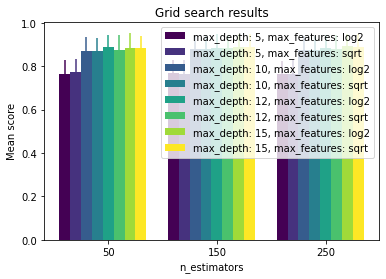

In [ ]:
# Display results from grid search
plot.grid_search(grid.cv_results_, change = 'n_estimators', kind = 'bar')

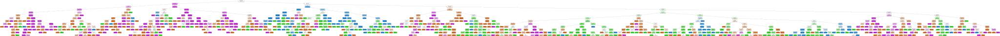

In [ ]:
# Tree after optimization
rf = RandomForestClassifier(n_estimators = 50, max_depth = 12, max_features = 'log2')
clf2 = rf.fit(X_train, Y_train)
dot_data = export_graphviz(clf2.estimators_[0],
                feature_names=X.columns,
                filled=True,
                rounded=True)

graph = graphviz.Source(dot_data)
graph

In [ ]:
# Predictions after optimization
predictions = grid.predict(X_test)
predicted_probas = grid.predict_proba(X_test)

print(classification_report(Y_test, predictions))
print('Predicted labels: ', predictions)
print('Accuracy: ', accuracy_score(Y_test, predictions))

              precision    recall  f1-score   support

         25%       1.00      1.00      1.00       714
         50%       1.00      1.00      1.00       652
       75% +       1.00      1.00      1.00       728
         Min       1.00      1.00      1.00       714

    accuracy                           1.00      2808
   macro avg       1.00      1.00      1.00      2808
weighted avg       1.00      1.00      1.00      2808

Predicted labels:  ['Min' 'Min' '25%' ... '25%' '50%' '75% +']
Accuracy:  1.0


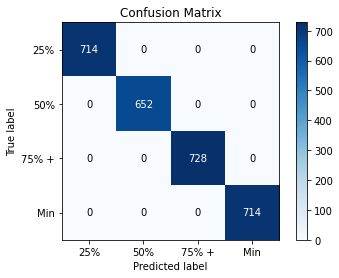

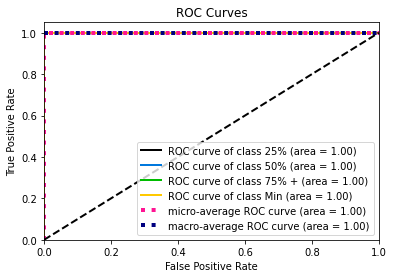

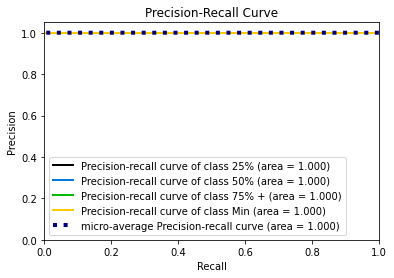

In [ ]:
skplt.metrics.plot_confusion_matrix(Y_test, predictions)
skplt.metrics.plot_roc(Y_test, predicted_probas)
skplt.metrics.plot_precision_recall_curve(Y_test, predicted_probas)
plt.show()

# Classification Metrics - AdaBoost

In [ ]:
adab = AdaBoostClassifier(random_state = 5)
clf1 = adab.fit(X_train, Y_train)

In [ ]:
# Report before optimizing
predictions = adab.predict(X_test)
predicted_probas = adab.predict_proba(X_test)

print(classification_report(Y_test, predictions))
print('Predicted labels: ', predictions)
print('Accuracy: ', accuracy_score(Y_test, predictions))

              precision    recall  f1-score   support

         25%       0.65      0.87      0.75       714
         50%       0.62      0.94      0.75       652
       75% +       1.00      0.60      0.75       728
         Min       1.00      0.58      0.74       714

    accuracy                           0.75      2808
   macro avg       0.82      0.75      0.75      2808
weighted avg       0.82      0.75      0.75      2808

Predicted labels:  ['25%' 'Min' '25%' ... '25%' '50%' '75% +']
Accuracy:  0.7453703703703703


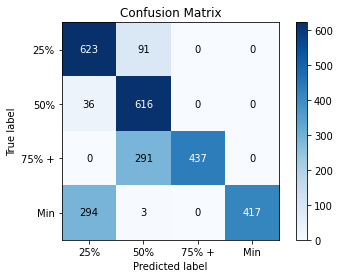

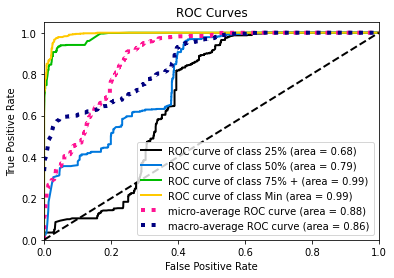

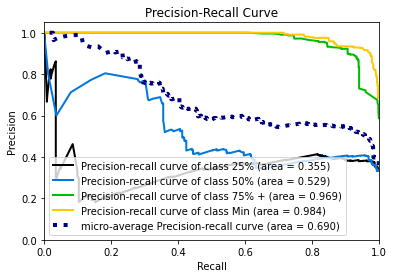

In [ ]:
# Plot classification
skplt.metrics.plot_confusion_matrix(Y_test, predictions)
skplt.metrics.plot_roc(Y_test, predicted_probas)
skplt.metrics.plot_precision_recall_curve(Y_test, predicted_probas)
plt.show()

In [ ]:
# Create XGBoost model and parameterize
clf = GridSearchCV(adab, {'n_estimators':[50, 150, 250],
                          'learning_rate':[.001, 0.01, .1, 1],
                          'random_state':[5]}, verbose = 1, n_jobs = 2, cv = 10)

# Fit model and print results
clf.fit(X, Y)
print(clf.best_score_)
print(clf.best_params_)

Fitting 10 folds for each of 12 candidates, totalling 120 fits
0.8302712646830294
{'learning_rate': 1, 'n_estimators': 250, 'random_state': 5}


In [ ]:
# Report after optimizing
predictions = clf.predict(X_test)
predicted_probas = clf.predict_proba(X_test)

print(classification_report(Y_test, predictions))
print('Predicted labels: ', predictions)
print('Accuracy: ', accuracy_score(Y_test, predictions))

              precision    recall  f1-score   support

         25%       0.76      0.98      0.86       714
         50%       0.78      0.90      0.84       652
       75% +       0.99      0.79      0.88       728
         Min       1.00      0.78      0.87       714

    accuracy                           0.86      2808
   macro avg       0.88      0.86      0.86      2808
weighted avg       0.89      0.86      0.86      2808

Predicted labels:  ['25%' 'Min' '25%' ... '25%' '50%' '75% +']
Accuracy:  0.8611111111111112


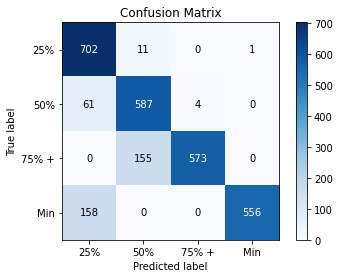

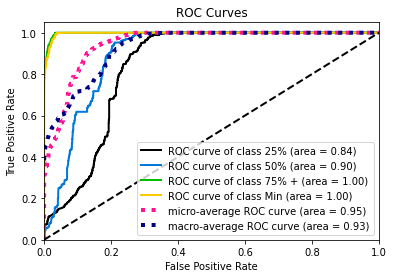

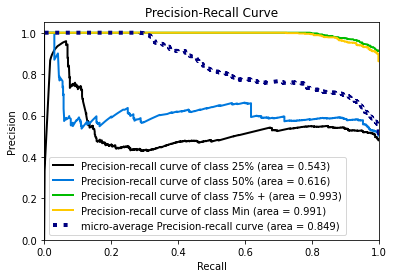

In [ ]:
# Plot classification
skplt.metrics.plot_confusion_matrix(Y_test, predictions)
skplt.metrics.plot_roc(Y_test, predicted_probas)
skplt.metrics.plot_precision_recall_curve(Y_test, predicted_probas)
plt.show()

# Classification Metrics - XGBoost

In [ ]:
xgb1 = xgb.XGBClassifier(random_state = 5)
xgb1.fit(X_train, Y_train)

XGBClassifier(objective='multi:softprob', random_state=5)

In [ ]:
# Report after optimizing
y_pred = xgb1.predict(X)
y_probs = xgb1.predict_proba(X)

print(classification_report(Y, y_pred))
print('Predicted labels: ', y_pred)
print('Accuracy: ', accuracy_score(Y, y_pred))

              precision    recall  f1-score   support

         25%       0.96      0.96      0.96      2525
         50%       0.95      0.96      0.96      2153
       75% +       0.99      0.98      0.98      2336
         Min       0.99      0.98      0.99      2343

    accuracy                           0.97      9357
   macro avg       0.97      0.97      0.97      9357
weighted avg       0.97      0.97      0.97      9357

Predicted labels:  ['25%' '25%' '25%' ... '75% +' '75% +' '75% +']
Accuracy:  0.9732820348402266


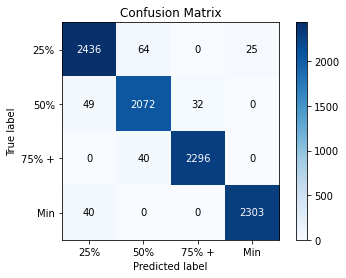

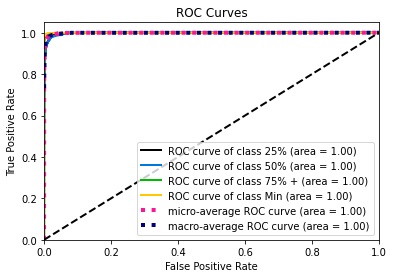

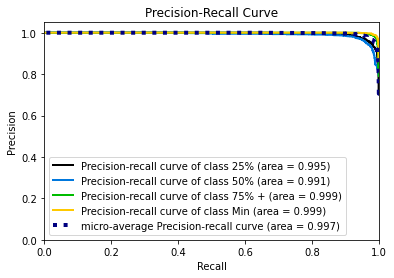

In [ ]:
# Plot classification
skplt.metrics.plot_confusion_matrix(Y, y_pred)
skplt.metrics.plot_roc(Y, y_probs)
skplt.metrics.plot_precision_recall_curve(Y, y_probs)
plt.show()

In [ ]:
# Create XGBoost model and parameterize
xgb_model = xgb.XGBClassifier(n_jobs = multiprocessing.cpu_count() // 2)
clf = GridSearchCV(xgb_model, {'max_depth': [5, 10, 15],
                               'n_estimators': [25, 50, 100],
                               'random_state': [5]}, verbose = 1, n_jobs = 2, cv = 10)

# Fit model and print results
clf.fit(X, Y)
print(clf.best_score_)
print(clf.best_params_)

Fitting 10 folds for each of 9 candidates, totalling 90 fits
0.9566031354266649
{'max_depth': 15, 'n_estimators': 25, 'random_state': 5}


In [ ]:
# Report after optimizing
y_pred = clf.predict(X)
y_probs = clf.predict_proba(X)

print(classification_report(Y, y_pred))
print('Predicted labels: ', y_pred)
print('Accuracy: ', accuracy_score(Y, y_pred))

              precision    recall  f1-score   support

         25%       1.00      1.00      1.00      2525
         50%       1.00      1.00      1.00      2153
       75% +       1.00      1.00      1.00      2336
         Min       1.00      1.00      1.00      2343

    accuracy                           1.00      9357
   macro avg       1.00      1.00      1.00      9357
weighted avg       1.00      1.00      1.00      9357

Predicted labels:  ['25%' '25%' 'Min' ... '75% +' '75% +' '75% +']
Accuracy:  1.0


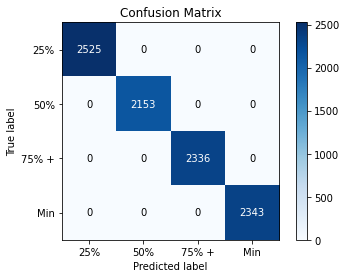

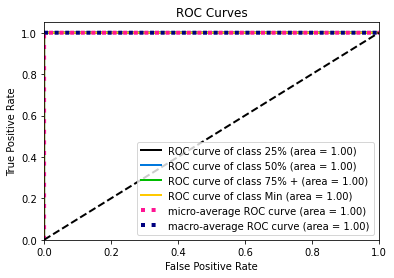

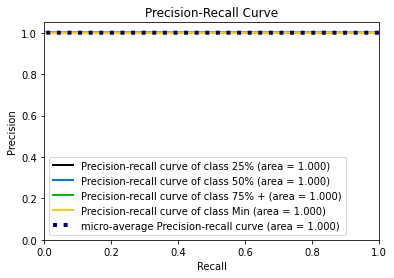

In [ ]:
# Plot classification
skplt.metrics.plot_confusion_matrix(Y, y_pred)
skplt.metrics.plot_roc(Y, y_probs)
skplt.metrics.plot_precision_recall_curve(Y, y_probs)
plt.show()

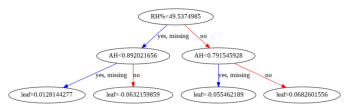

In [ ]:
# Plot tree
xgb1 = xgb.XGBClassifier(max_depth = 2, n_estimators = 200,
                         n_jobs=multiprocessing.cpu_count() // 2)
clf1 = xgb1.fit(X_train, Y_train)
xgb.plot_tree(xgb1)
